In [1]:
import pandas as pd
import numpy as np
import re
import datetime
import seaborn as sns
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import warnings
warnings.filterwarnings('ignore')

### Extract Files 

In [2]:
confirmed_g = pd.read_csv('files/time_series_covid19_confirmed_global.csv')
death_g = pd.read_csv('files/time_series_covid19_deaths_global.csv')
recovered_g = pd.read_csv('files/time_series_covid19_recovered_global.csv')

### Data Wrangling 

In [3]:
dates = [x for x in list(confirmed_g.columns) if re.search('/.+/',x)]

In [4]:
confirmed_g_clean = confirmed_g.melt(id_vars=['Province/State','Country/Region','Lat','Long'], value_vars= dates).rename(columns={'variable':'Date','value':'Total Cases'})
confirmed_g_clean['Date'] = pd.to_datetime(confirmed_g_clean['Date'], errors ='coerce')
confirmed_g_clean.set_index('Date',inplace = True)
confirmed_g_clean

,Province/State,Country/Region,Lat,Long,Total Cases
Date,,,,,
2020-01-22,NaN,Afghanistan,33.939110,67.709953,0
2020-01-22,NaN,Albania,41.153300,20.168300,0
2020-01-22,NaN,Algeria,28.033900,1.659600,0
2020-01-22,NaN,Andorra,42.506300,1.521800,0
2020-01-22,NaN,Angola,-11.202700,17.873900,0
...,...,...,...,...,...
2020-08-02,NaN,Sao Tome and Principe,0.186400,6.613100,874
2020-08-02,NaN,Yemen,15.552727,48.516388,1734
2020-08-02,NaN,Comoros,-11.645500,43.333300,386


In [5]:
death_g_clean = death_g.melt(id_vars=['Province/State','Country/Region','Lat','Long'], value_vars= dates).rename(columns={'variable':'Date','value':'Total Death'})
death_g_clean['Date'] = pd.to_datetime(death_g_clean['Date'], errors ='coerce')
death_g_clean.set_index('Date',inplace = True)
death_g_clean

,Province/State,Country/Region,Lat,Long,Total Death
Date,,,,,
2020-01-22,NaN,Afghanistan,33.939110,67.709953,0
2020-01-22,NaN,Albania,41.153300,20.168300,0
2020-01-22,NaN,Algeria,28.033900,1.659600,0
2020-01-22,NaN,Andorra,42.506300,1.521800,0
2020-01-22,NaN,Angola,-11.202700,17.873900,0
...,...,...,...,...,...
2020-08-02,NaN,Sao Tome and Principe,0.186400,6.613100,15
2020-08-02,NaN,Yemen,15.552727,48.516388,497
2020-08-02,NaN,Comoros,-11.645500,43.333300,7


In [6]:
recovered_g_clean = recovered_g.melt(id_vars=['Province/State','Country/Region','Lat','Long'], value_vars= dates).rename(columns={'variable':'Date','value':'Total Recovered'})
recovered_g_clean['Date'] = pd.to_datetime(recovered_g_clean['Date'], errors ='coerce')
recovered_g_clean.set_index('Date',inplace = True)
recovered_g_clean

,Province/State,Country/Region,Lat,Long,Total Recovered
Date,,,,,
2020-01-22,NaN,Afghanistan,33.939110,67.709953,0
2020-01-22,NaN,Albania,41.153300,20.168300,0
2020-01-22,NaN,Algeria,28.033900,1.659600,0
2020-01-22,NaN,Andorra,42.506300,1.521800,0
2020-01-22,NaN,Angola,-11.202700,17.873900,0
...,...,...,...,...,...
2020-08-02,NaN,Sao Tome and Principe,0.186400,6.613100,787
2020-08-02,NaN,Yemen,15.552727,48.516388,862
2020-08-02,NaN,Comoros,-11.645500,43.333300,330


In [7]:
regions = confirmed_g['Country/Region'].unique()

In [8]:
data_g = {}

for region in regions:
    ### New cases
    new = confirmed_g_clean.loc[confirmed_g_clean['Country/Region'] == region]
    new_agg = new.groupby('Date')[['Total Cases']].sum().reset_index()
    new_agg['New Cases'] = [new_agg['Total Cases'][0]] + \
                [y-x if y>x else 0 for x,y in zip(new_agg['Total Cases'][:-1], new_agg['Total Cases'][1:])]
    new_agg.set_index('Date',inplace = True)   
    
    ### Death
    death = death_g_clean.loc[death_g_clean['Country/Region'] == region]
    death_agg = death.groupby('Date')[['Total Death']].sum().reset_index()
    death_agg['New Death'] =[death_agg['Total Death'][0]]+ \
                   [y-x if y>x else 0 for x,y in zip(death_agg['Total Death'][:-1],death_agg['Total Death'][1:])]
    death_agg.set_index('Date',inplace = True)
    
    ### Recovered
    recovered = recovered_g_clean.loc[recovered_g_clean['Country/Region'] == region]
    recovered_agg = recovered.groupby('Date')[['Total Recovered']].sum().reset_index()
    recovered_agg['New Recovered'] =[recovered_agg['Total Recovered'][0]]+ \
                   [y-x if y>x else 0 for x,y in zip(recovered_agg['Total Recovered'][:-1],recovered_agg['Total Recovered'][1:])]
    recovered_agg.set_index('Date',inplace = True)
    
    data_g['%s' % region] = new_agg.merge(death_agg, left_index = True, right_index = True).\
                                    merge(recovered_agg,left_index = True, right_index = True)
    data_g['%s' % region]['Country/Region'] = region
    data_g['%s' % region].reset_index(inplace = True)

## Total Cases by Countries (Top 10)

In [9]:
Top10_countries = list(confirmed_g_clean.loc['2020-07-05',:].sort_values(by = 'Total Cases', ascending = False)\
                       .head(10)['Country/Region'])
Top10 = confirmed_g_clean[confirmed_g_clean['Country/Region'].isin(Top10_countries)]

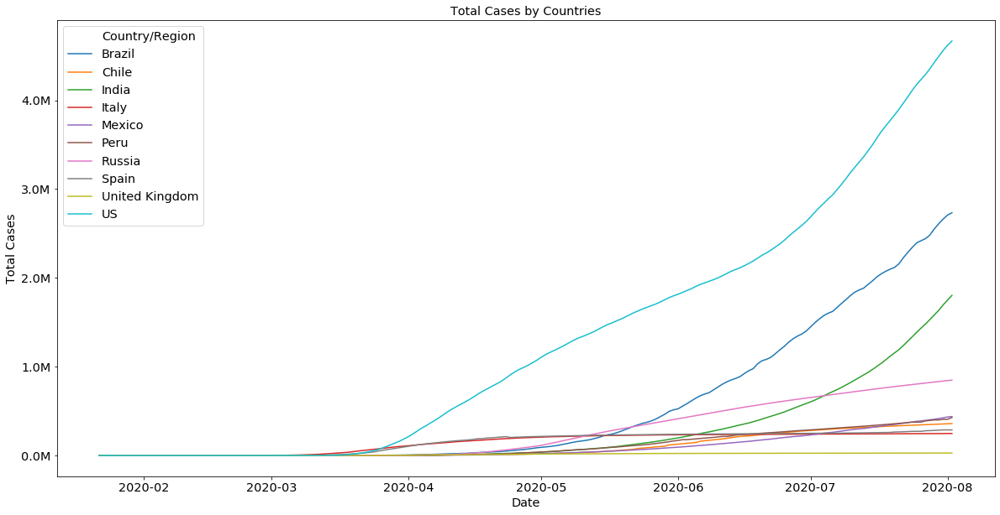

In [10]:
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (20, 10),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)
plt.title('Total Cases by Countries')
g = sns.lineplot(x='Date', y = 'Total Cases', data = Top10.reset_index(), hue = 'Country/Region',ci = None)
ylabels = ['{:,}'.format(x) + 'M' for x in g.get_yticks()/1000000]
g.set_yticklabels(ylabels);

## Trend of Daily Global New Cases

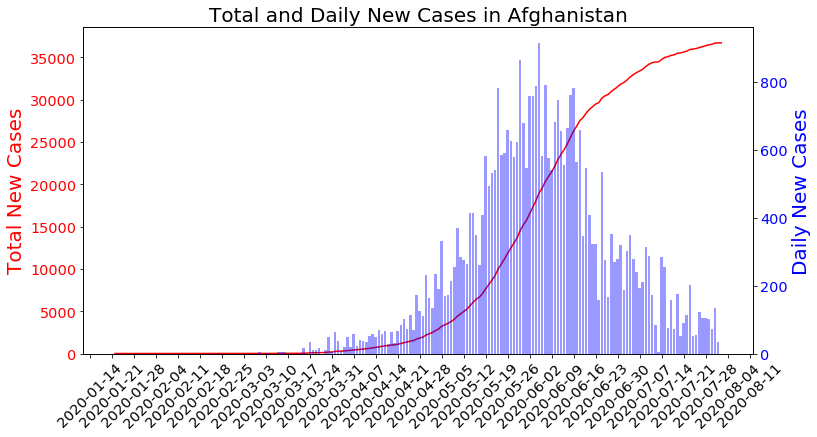

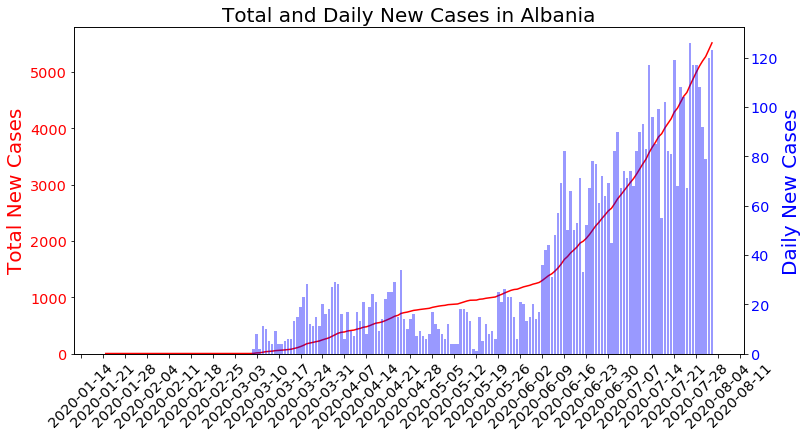

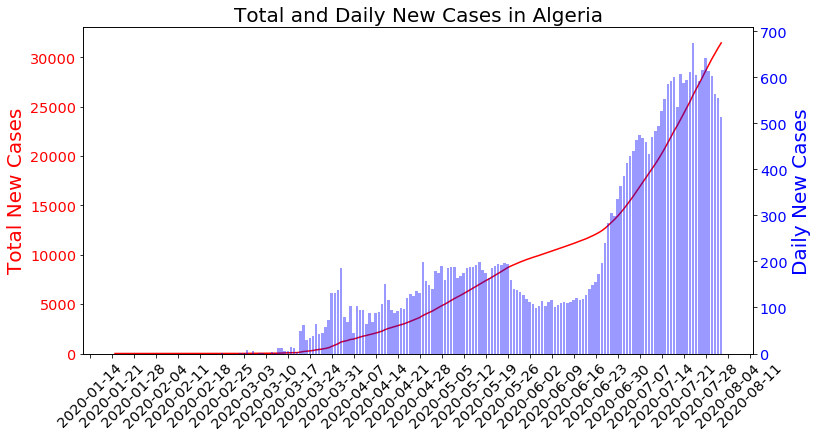

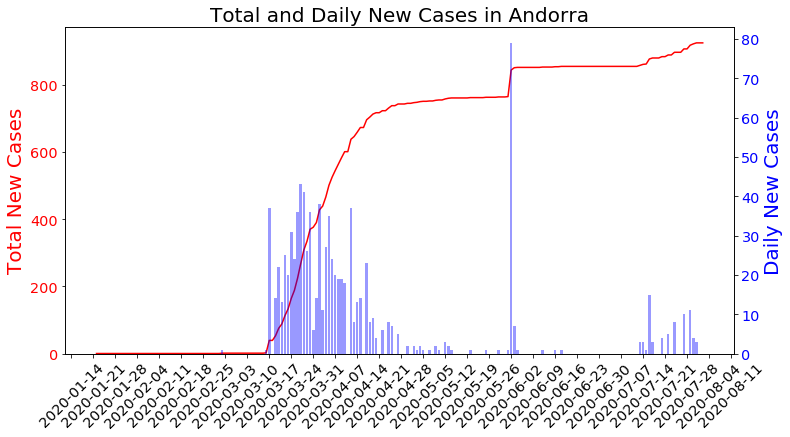

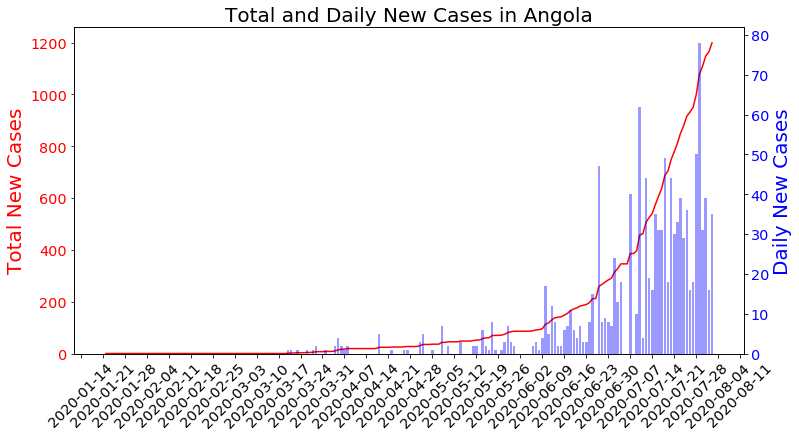

...

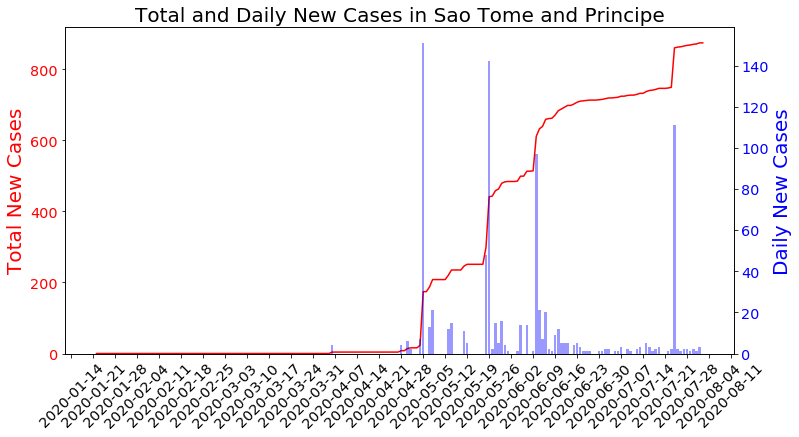

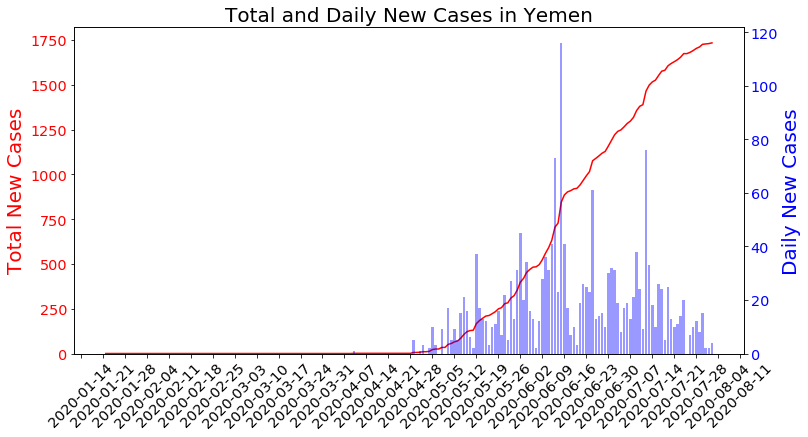

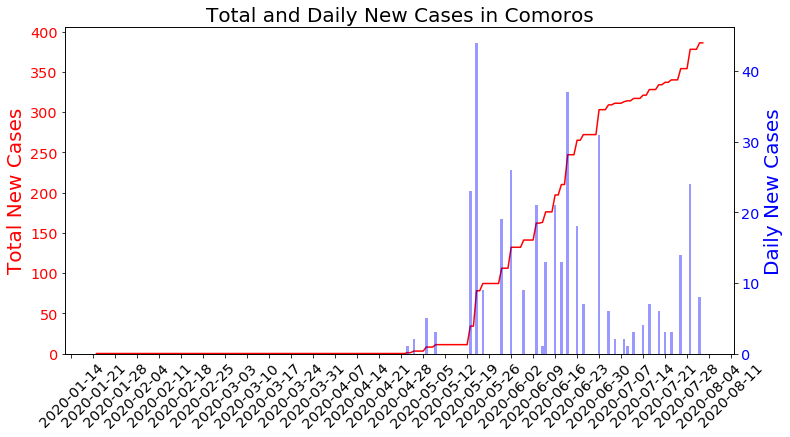

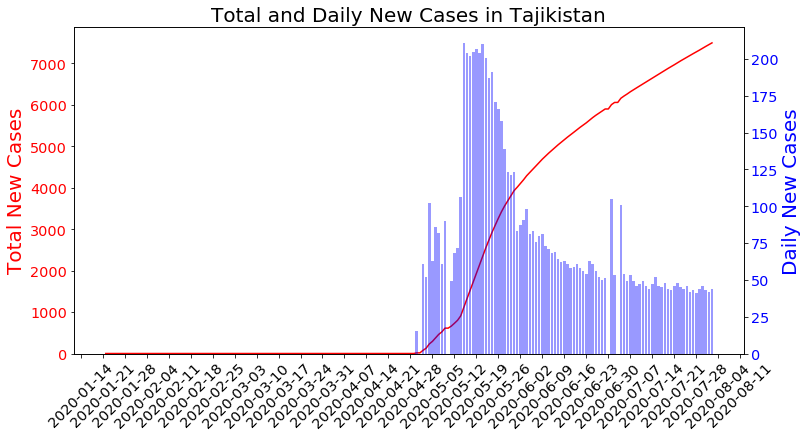

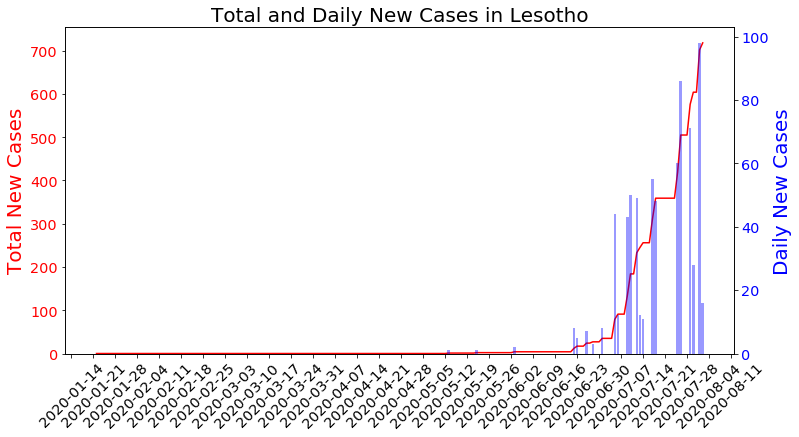

In [11]:
for region in regions:
    fig,ax1 = plt.subplots(figsize = (12,6))
    ax2 = ax1.twinx()
    ax1.plot(data_g['%s' % region]['Date'], data_g['%s' % region]['Total Cases'],'r-')
    ax1.tick_params(axis = 'y',labelcolor = 'r')
    ax1.tick_params(axis = 'x',labelrotation = 45)
    ax1.set_ylim(0)
    ax1.set_ylabel('Total New Cases', color = 'r',fontsize = 20)
    ax1.set_title('Total and Daily New Cases in %s' % region, fontsize = 20)
    
    ax2.bar(data_g['%s' % region]['Date'], data_g['%s' % region]['New Cases'],color = 'b',alpha = 0.4)
    ax2.tick_params(axis = 'y',labelcolor = 'b')
    ax2.set_ylabel('Daily New Cases', color = 'b',fontsize = 20)
    ax1.xaxis.set_major_locator(mdates.WeekdayLocator(interval = 1))
    plt.show();

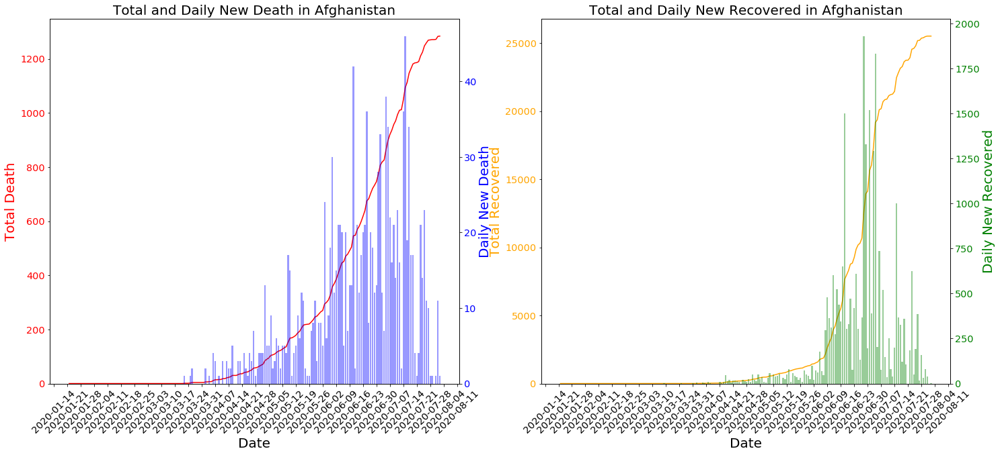

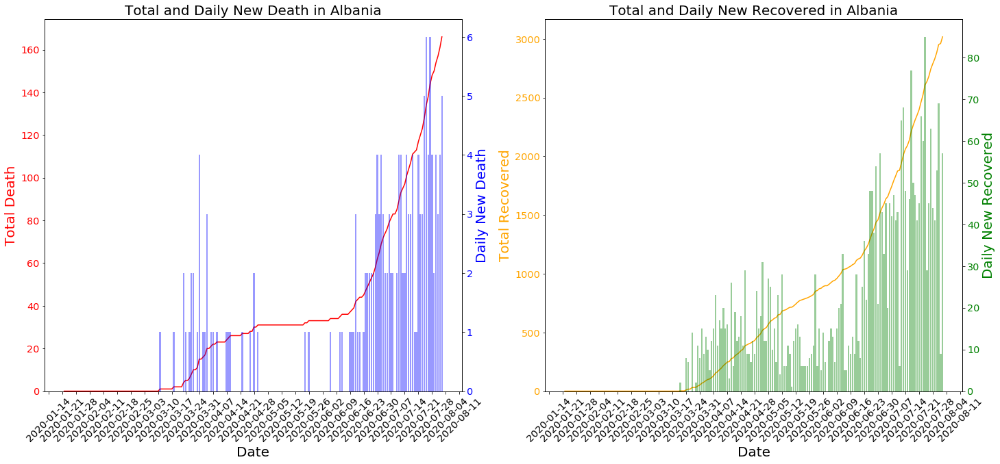

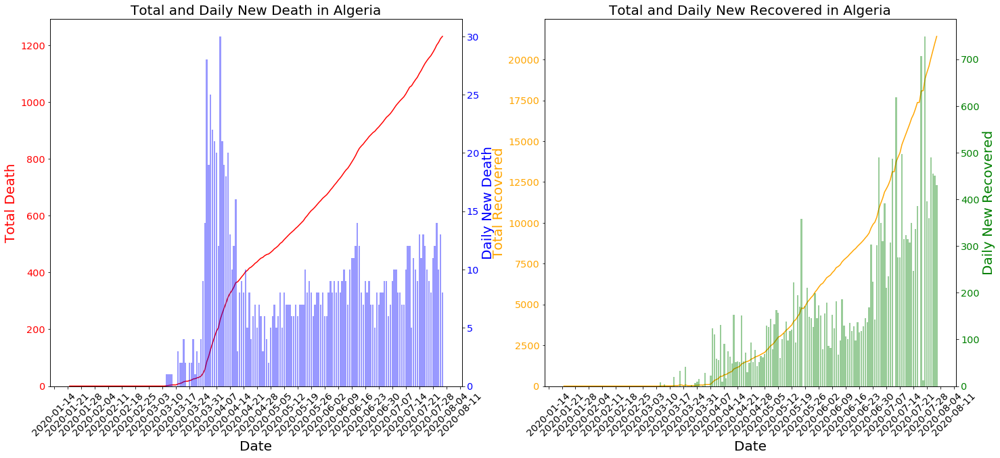

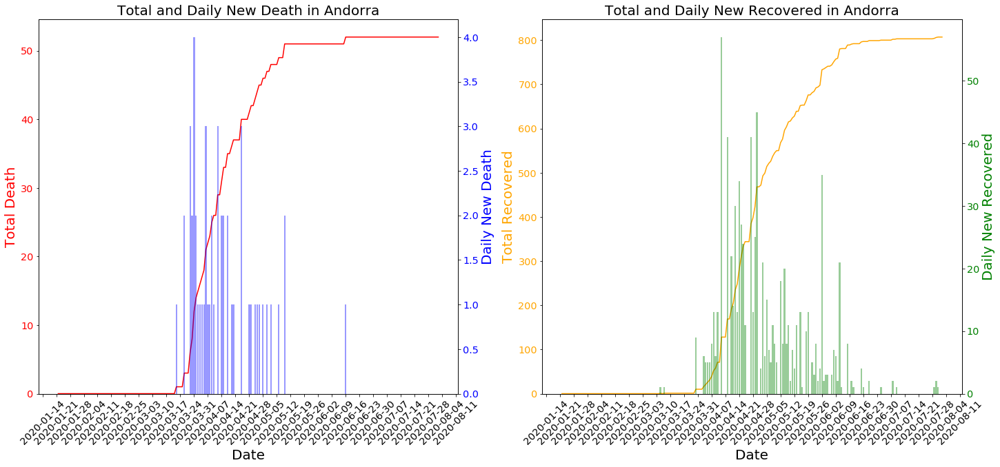

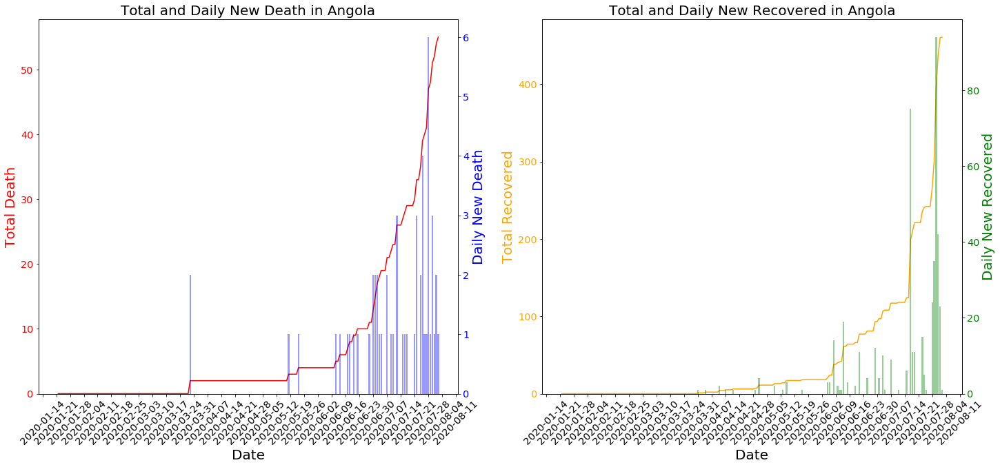

...

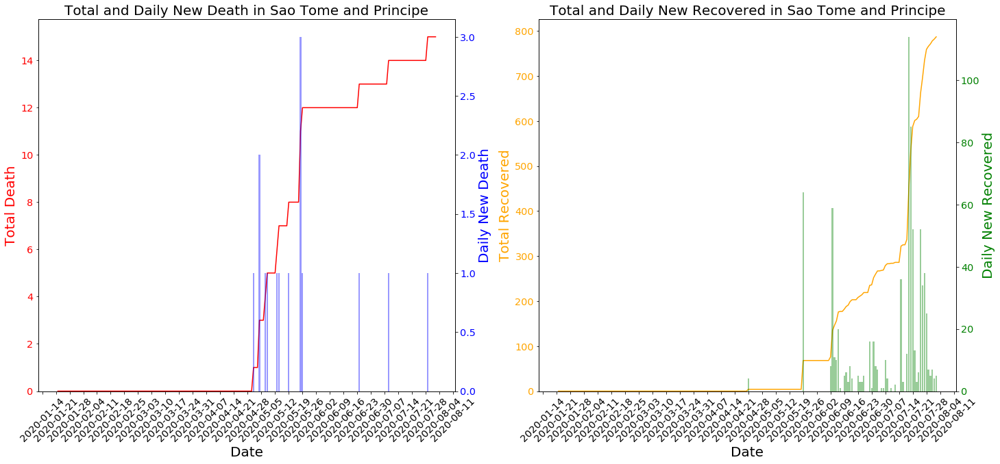

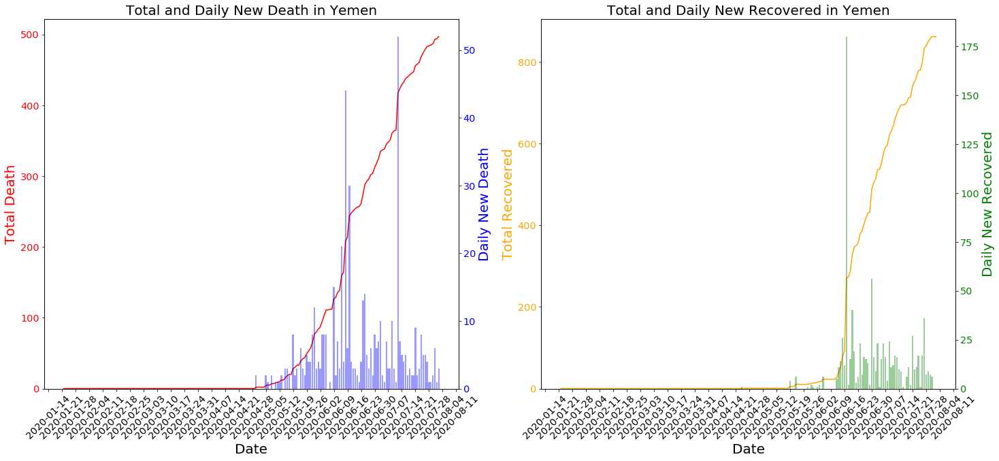

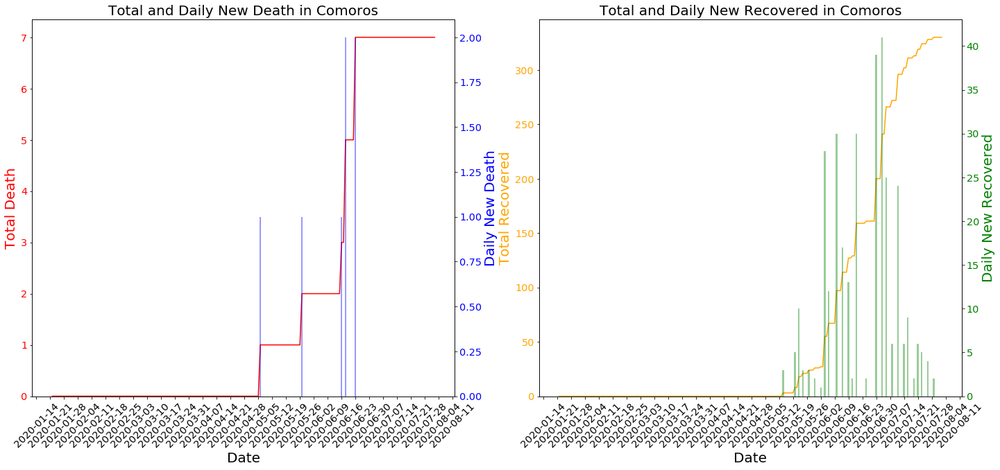

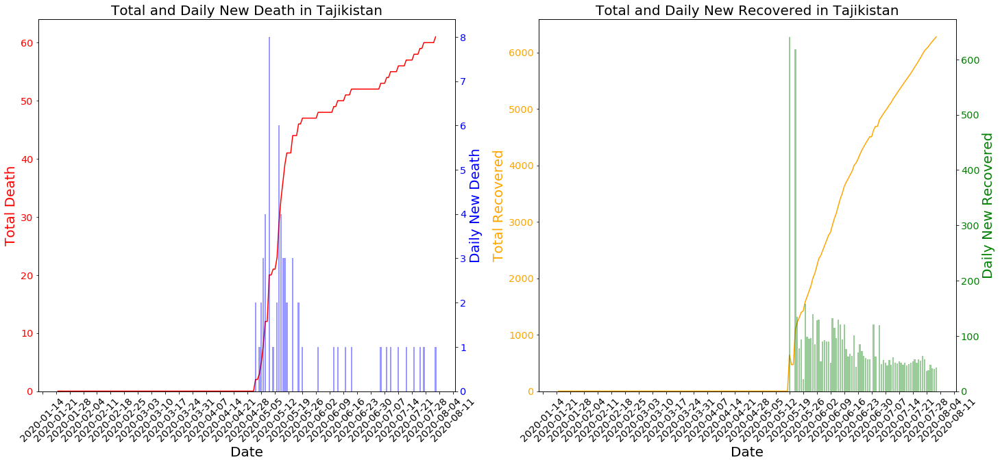

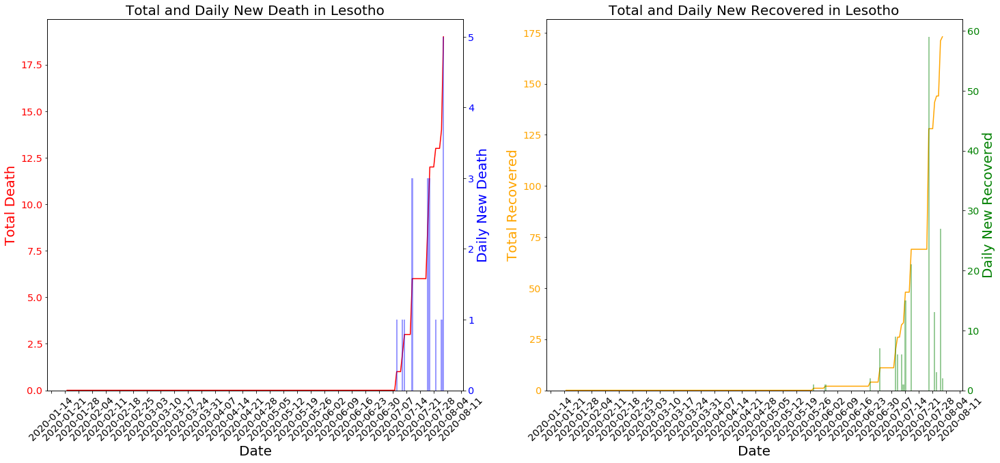

In [12]:
for region in regions:   
    fig, axs = plt.subplots(nrows = 1, ncols = 2, figsize=(24,10))
    ax2 = axs[0].twinx()
    ax3 = axs[1].twinx()
    axs[0].plot(data_g['%s' % region]['Date'], data_g['%s' % region]['Total Death'], 'r-')
    axs[0].tick_params(axis = 'y', labelcolor='r')
    axs[0].tick_params(axis = 'x', labelrotation = 45)
    axs[0].set_ylim(0)
    axs[0].set_xlabel('Date',fontsize = 20)
    axs[0].set_ylabel('Total Death', color='r',fontsize = 20)
    
    ax2.bar(data_g['%s' % region]['Date'],data_g['%s' % region]['New Death'], color = 'b', alpha= 0.4)
    ax2.tick_params(axis = 'y',labelcolor='b')
    ax2.set_ylabel('Daily New Death', color='b',fontsize = 20)
    
    axs[0].xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
    axs[0].set_title('Total and Daily New Death in %s' % region,fontsize = 20)

    axs[1].plot(data_g['%s' % region]['Date'], data_g['%s' % region]['Total Recovered'], '-',color = 'orange')
    axs[1].tick_params(axis = 'y', labelcolor='orange')
    axs[1].tick_params(axis = 'x', labelrotation = 45)
    axs[1].set_ylim(0)
    axs[1].set_xlabel('Date',fontsize = 20)
    axs[1].set_ylabel('Total Recovered', color='orange',fontsize = 20)
    ax3.bar(data_g['%s' % region]['Date'], data_g['%s' % region]['New Recovered'], color = 'green', alpha= 0.4)
    ax3.tick_params(axis = 'y',labelcolor='green')
    ax3.set_ylabel('Daily New Recovered', color='green',fontsize = 20)
    
    axs[1].xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
    axs[1].set_title('Total and Daily New Recovered in %s' %region,fontsize = 20)
    plt.show();